In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import numpy as np
import os
import pickle as p
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import networkx as nx
import sys
import slam.io as sio
import networkx as nx
import tools.graph_visu as gv
import tools.graph_processing as gp
import matplotlib.pyplot as plt
import random
import plotly.express as px
import plotly.figure_factory as ff
import trimesh
import slam.topology as stop
from sphere import *

In [3]:
#generate random color codes for plotting
def generate_random_color_codes(num_colors):
    
    number_of_colors = num_colors
    
    color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(number_of_colors)]
    
    return color

In [4]:
def remove_dummy_nodes(graph):
    G = graph.copy()
    to_remove = []
    for (p, d) in G.nodes(data=True):
        if d['is_dummy'] == True:
            to_remove.append(p)
    G.remove_nodes_from(to_remove)
    return G

In [5]:
simu_path = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/simu_graph/0/"

In [6]:
folder_name = os.listdir(simu_path)

In [7]:
folder_name

['reference_0.gpickle',
 'noise_1000,outliers_4',
 'noise_1000,outliers_8',
 'noise_1000,outliers_12',
 'noise_1000,outliers_16',
 'noise_1000,outliers_0']

In [9]:
path_1 = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/simu_graph/0/noise_1000,outliers_0/graphs/"
real_path = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/OASIS_full_batch/modified_graphs/"

# degree distribution simulated graph

In [10]:
# Degree for simulated graph
degree_list = []
for graph in os.listdir(path_1):
    G = p.load(open(path_1 + graph, "rb" )) #read the graphs
    #new_G = remove_dummy_nodes(G)
    #new_G.remove_edges_from(nx.selfloop_edges(new_G)) # remove self loops
    degree_list.append(list(dict(nx.degree(G)).values()))

In [11]:
avg_degree = []
avg_std = []
for degrees in degree_list:
    avg_degree.append(np.mean(degrees))
    avg_std.append(np.std(degrees))

In [12]:
def errorfill(x, y, yerr, color=None, alpha_fill=0.2, ax=None,label = None):
    ax = ax if ax is not None else plt.gca()
    if color is None:
        color = next(ax._get_lines.prop_cycler)['color']
    if np.isscalar(yerr) or len(yerr) == len(y):
        ymin = y - yerr
        ymax = y + yerr
    elif len(yerr) == 2:
        ymin, ymax = yerr
    ax.plot(x, y, color=color,label= label)
    ax.legend(loc='upper right')
    ax.fill_between(x, ymax, ymin, color=color, alpha=alpha_fill)

In [13]:
# Degree for Real graph
degree_list_real = []
for graph in os.listdir(real_path):
    G = p.load(open(real_path + graph, "rb" )) #read the graphs
    new_G = remove_dummy_nodes(G)
    new_G.remove_edges_from(nx.selfloop_edges(new_G)) # remove self loops
    degree_list_real.append(list(dict(nx.degree(new_G)).values()))

In [14]:
avg_degree_real = []
avg_std_real = []
for degrees in degree_list_real:
    avg_degree_real.append(np.mean(degrees))
    avg_std_real.append(np.std(degrees))

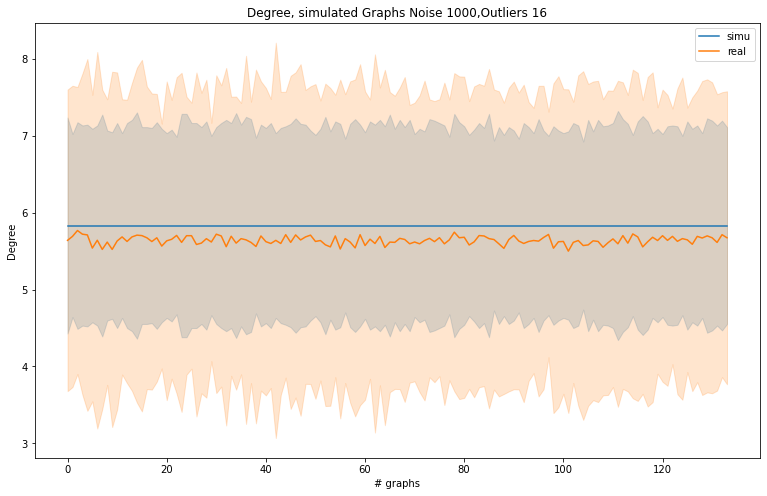

In [16]:
plt.figure(figsize=(13,8))

errorfill(np.arange(0,len(avg_degree)),np.array(avg_degree), np.array(avg_std),label="simu")
errorfill(np.arange(0,len(avg_degree_real)),np.array(avg_degree_real), np.array(avg_std_real),label='real')

plt.title("Degree, simulated Graphs Noise 1000,Outliers 16")
plt.xlabel('# graphs')
plt.ylabel('Degree')
plt.show()

In [37]:
color = generate_random_color_codes(len(degree_list)+len(degree_list_real))

real_graph_names = ["R_"+names for names in os.listdir(real_path)]


fig = ff.create_distplot(degree_list + degree_list_real, os.listdir(path_1)+real_graph_names, show_hist=False, colors=color)
#fig = ff.create_distplot([avg_degree_list, avg_degree_list_real], ["avg_degree_simu","avg_degree_real"], show_hist=False, colors=color)

# Add title
fig.update_layout(title_text='Degree density simu 1000 noise 0 outliers and Real data')
fig.show()

# average neighbour degree distribution

In [28]:
def degree_of_neighb(G):
    nb_degree_dict = {}
    for node in G:
        nb_degree = []
        for nb in G.neighbors(node):
            nb_degree.append(G.degree(nb))
        nb_degree_dict[node] = nb_degree
    return nb_degree_dict

In [33]:
all_graph_nb_degree = []
for graph in os.listdir(path_1):
    graph = nx.read_gpickle(path_1+graph)
    #graph = remove_dummy_nodes(graph)
    #graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
    all_graph_nb_degree.append(degree_of_neighb(graph))

In [34]:
avg_nb_degree_all_graph = []
for degree_dict in all_graph_nb_degree:
    avg_degree = [np.mean(lst) for lst in list(degree_dict.values())]
    avg_nb_degree_all_graph.append(avg_degree)

In [689]:
color = generate_random_color_codes(len(avg_nb_degree_all_graph))
fig = ff.create_distplot(avg_nb_degree_all_graph, os.listdir(path_1), show_hist=False,bin_size=.2, colors=color)

# Add title
fig.update_layout(title_text='Average neigbour degree for simu graphs 900 noise 0 outliers')
fig.show()

# Average Neighbour Geo distance

In [49]:
# neighbours geo distance

def geo_dist_of_neighb(G):
    nb_dist_dict = {}
    for node in G:
        nb_geo_dist = []
        for nb in G.neighbors(node):
            nb_geo_dist.append(G.get_edge_data(node,nb)['geodesic_distance'])
        nb_dist_dict[node] = nb_geo_dist
    return nb_dist_dict

In [691]:
all_graph_nb_distance = []
for graph in os.listdir(path_1):
    graph = nx.read_gpickle(path_1+graph)
    #graph = remove_dummy_nodes(graph)
    #graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
    all_graph_nb_distance.append(geo_dist_of_neighb(graph))

In [692]:
avg_nb_dist_all_graph = []
for dist_dict in all_graph_nb_distance:
    avg_dist = [np.mean(lst) for lst in list(dist_dict.values())]
    avg_nb_dist_all_graph.append(avg_dist)

In [694]:
color = generate_random_color_codes(len(avg_nb_dist_all_graph))
fig = ff.create_distplot(avg_nb_dist_all_graph, os.listdir(path_1), show_hist=False,bin_size=.2, colors=color)

# Add title
fig.update_layout(title_text='Average neigbour geo distance for simu graphs 900 noise 0 outliers')
fig.show()

## Average geo distance Real and Simu

In [17]:
real_path = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/OASIS_full_batch/modified_graphs/"
path_1 = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/simu_graph/0/noise_1000,outliers_0/graphs/"
simu_path = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/simu_graph/0/"

In [18]:
def mean_edge_len(G):
    
    all_geo = [z['geodesic_distance'] for x,y,z in list(G.edges.data())]
    mean_geo = np.array(all_geo).mean()
    std = np.std(all_geo)
    
    return mean_geo,std

In [19]:
simu_graph_geo_distance = []
simu_graph_std = []
for folder in folder_name:
    if os.path.isdir(simu_path+folder):
        print(folder)
    
        mean_graph_geo_distance = []
        mean_graph_std = []
        
        graph_path = simu_path+folder+'/'+'graphs/'
        
        for graph in os.listdir(graph_path):
            graph = nx.read_gpickle(graph_path+graph)
            #graph = remove_dummy_nodes(graph)
            #graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
            
            mean_geo,mean_std = mean_edge_len(graph)
            
            mean_graph_geo_distance.append(mean_geo)
            mean_graph_std.append(mean_std)
        
        simu_graph_geo_distance.append(mean_graph_geo_distance)
        simu_graph_std.append(mean_graph_std)

noise_1000,outliers_4
noise_1000,outliers_8
noise_1000,outliers_12
noise_1000,outliers_16
noise_1000,outliers_0


In [20]:
real_graph_geo_distance = []
real_graph_std = []
for graph in os.listdir(real_path):
    graph = nx.read_gpickle(real_path+graph)
    graph = remove_dummy_nodes(graph)
    graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
    
    mean_geo,mean_std = mean_edge_len(graph)
    
    real_graph_geo_distance.append(mean_geo)
    real_graph_std.append(mean_std)

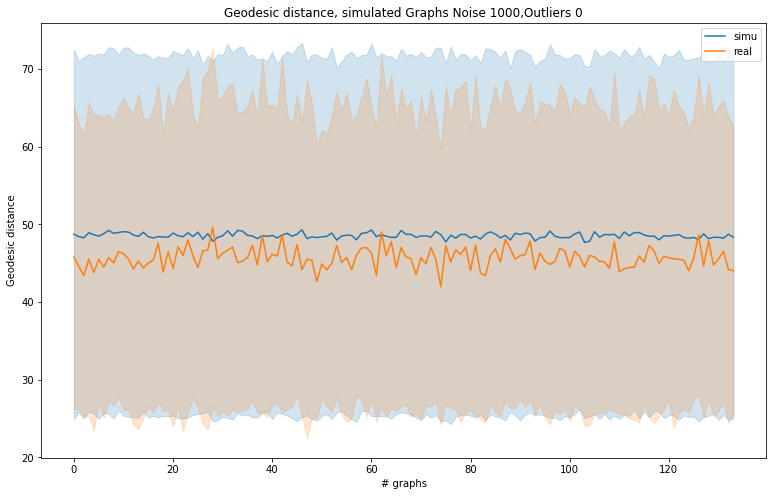

In [21]:
plt.figure(figsize=(13,8))

errorfill(np.arange(0,len(simu_graph_geo_distance[4])),np.array(simu_graph_geo_distance[4]), np.array(simu_graph_std[4]),label="simu")
errorfill(np.arange(0,len(real_graph_geo_distance)),np.array(real_graph_geo_distance), np.array(real_graph_std),label='real')

plt.title("Geodesic distance, simulated Graphs Noise 1000,Outliers 0")
plt.xlabel('# graphs')
plt.ylabel('Geodesic distance')
plt.show()

In [24]:
#color = generate_random_color_codes(len(real_graph_geo_distance)+len(simu_graph_geo_distance))
simu_graph_names = [name for name in os.listdir(simu_path) if os.path.isdir(simu_path+name)]

color = generate_random_color_codes(len(simu_graph_names)+1)

#real_graph_names = ["R_"+names for names in os.listdir(real_path)]

fig = ff.create_distplot([real_graph_geo_distance]+simu_graph_geo_distance,["real_graph"] + simu_graph_names
                         , show_hist=False,bin_size=.2, colors=color)

# Add title
fig.update_layout(title_text='Average Geo distance for simu graphs and real graphs')
fig.show()

In [ ]:
x1 = np.random.normal(0, 0.8, 1000)
x2 = np.random.normal(-2, 1, 1000)
x3 = np.random.normal(3, 2, 1000)

kwargs = dict(histtype='stepfilled', alpha=0.5, bins=40)

plt.hist(x1, **kwargs)
plt.hist(x2, **kwargs)
plt.hist(x3, **kwargs);

In [ ]:
ground_truth_permutation = np.random.permutation(5)

In [ ]:
for original_node, current_node in enumerate(ground_truth_permutation):
    print(original_node,current_node)

In [ ]:
np.linalg.norm(np.array([2,3,4]))

In [ ]:
a = np.random.multivariate_normal(np.zeros(3), np.eye(3) * 5)

In [ ]:
noisy_coordinate = np.array([-0.3911855 ,  4.85146353, -1.01699333])

In [ ]:
noisy_coordinate / np.linalg.norm(noisy_coordinate) * 100

In [2]:
def generate_sphere_random_sampling(vertex_number=100, radius=1.0):
    """
    generate a sphere with random sampling
    :param vertex_number: number of vertices in the output spherical mesh
    :param radius: radius of the output sphere
    :return:
    """
    coords = np.zeros((vertex_number, 3))
    for i in range(vertex_number):
        M = np.random.normal(size=(3, 3))
        Q, R = np.linalg.qr(M)
        coords[i, :] = Q[:, 0].transpose() * np.sign(R[0, 0])
    if radius != 1:
        coords = radius * coords
    return coords

In [3]:
def tri_from_hull(vertices):
    """
    compute faces from vertices using trimesh convex hull
    :param vertices: (n, 3) float
    :return:
    """
    mesh = trimesh.Trimesh(vertices=vertices, process=False)
    return mesh.convex_hull

In [15]:
sphere_random_sampling = generate_sphere_random_sampling(vertex_number=4, radius=50)

In [68]:
tri_f = tri_from_hull(sphere_random_sampling)

In [16]:
sphere_random_sampling

array([[ -7.41383767,  43.29289518, -23.8905889 ],
       [ 37.55112948,   8.51539875,  31.89671863],
       [-46.10565396,   8.97489307,  17.13826033],
       [ 37.02413109, -25.11894795, -22.32156291]])

In [69]:
graph.nodes[0]['coord']

array([-7.78404315, 29.69291922, 95.1721557 ])

In [70]:
edges_demo = tri_from_hull(list(nx.get_node_attributes(graph,'coord').values()))

In [71]:
adja = stop.edges_to_adjacency_matrix(edges_demo)

In [75]:
edge_list = [tuple((u,v)) for u,v in zip(adja.nonzero()[0],adja.nonzero()[1])]

In [74]:
adja.todense()

matrix([[0, 0, 2, ..., 0, 2, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=int8)

In [ ]:
coordinate_a, coordinate_b = noisy_graph.nodes[edge[0]]["coord"], noisy_graph.nodes[edge[1]]["coord"]

In [654]:
def generate_noisy_graph_2(original_graph, nb_vertices, sigma_noise_nodes=1, sigma_noise_edges=1, radius=100):
    # Perturbate the coordinates
    # noisy_coord = [points+np.random.multivariate_normal(np.zeros(3), np.eye(3) * sigma_noise_nodes)
    # 	for points in list(nx.get_node_attributes(original_graph,'coord').values())]

    ground_truth_permutation = np.arange(nb_vertices)
    # create a new graph
    noisy_graph = nx.Graph()
    # add the nodes (not very clean but it works fine and run in no time)
    for node_to_add in range(len(ground_truth_permutation)):
        for original_node, current_node in enumerate(ground_truth_permutation):
            if current_node == node_to_add:
                # noisy_coordinate = original_graph.nodes[original_node]["coord"] + \
                # 	np.random.multivariate_normal(np.zeros(3), np.eye(3) * sigma_noise_nodes)

                # Sampling from Von Mises - Fisher distribution
                original_coord = original_graph.nodes[original_node]["coord"]
                mean_original = original_coord / np.linalg.norm(original_coord)  # convert to mean vector
                noisy_coordinate = Sphere().sample(1, distribution='vMF', mu=mean_original,
                                                   kappa=sigma_noise_nodes).sample[0]

                #noisy_coordinate = noisy_coordinate / np.linalg.norm(noisy_coordinate) * radius
                noisy_coordinate  = noisy_coordinate * np.linalg.norm(original_coord)
                noisy_graph.add_node(node_to_add, coord=noisy_coordinate)

    return noisy_graph

In [11]:
def generate_noisy_graph(original_graph, nb_vertices, sigma_noise_nodes = 1, sigma_noise_edges = 1, radius = 100):
    
    # generate ground_truth permutation
    #ground_truth_permutation = np.random.permutation(nb_vertices)
    ground_truth_permutation = np.arange(nb_vertices)
    
    # create a new graph
    noisy_graph = nx.Graph()

    # add the nodes (not very clean but it works fine and run in no time)
    for node_to_add in range(len(ground_truth_permutation)):
        for original_node, current_node in enumerate(ground_truth_permutation):
            if current_node == node_to_add:
                noisy_coordinate = original_graph.nodes[original_node]["coord"] + \
                    np.random.multivariate_normal(np.zeros(3), np.eye(3) * sigma_noise_nodes)

                # We project on the sphere
                noisy_coordinate = noisy_coordinate / np.linalg.norm(noisy_coordinate) * radius
                noisy_graph.add_node(node_to_add, coord = noisy_coordinate)

    # add the necessary nodes
    # for original_node, corresponding_node in enumerate(ground_truth_permutation):
    #     noisy_coordinate = original_graph.nodes[original_node]["coord"] + \
    #                        np.random.multivariate_normal(np.zeros(3), np.eye(3) * sigma_noise_nodes)
    #     # On projete ce point sur la sphère
    #     noisy_coordinate = noisy_coordinate / np.linalg.norm(noisy_coordinate) * radius
    #     noisy_graph.add_node(corresponding_node, coord = noisy_coordinate)
        
    compute_noisy_edges = tri_from_hull(list(nx.get_node_attributes(noisy_graph,'coord').values())) # take all peturbated coord and comp conv hull.
    adja = stop.edges_to_adjacency_matrix(compute_noisy_edges) # compute the new adjacency mat
    edge_list = [tuple((u,v)) for u,v in zip(adja.nonzero()[0],adja.nonzero()[1])] # convert to edge list to add edge attributes.


    # add the edges
    for edge in edge_list:

        # get the original and corresponding ends
        #end_a_corresponding, end_b_corresponding = ground_truth_permutation[edge[0]], ground_truth_permutation[edge[1]]
        coordinate_a, coordinate_b = noisy_graph.nodes[edge[0]]["coord"], noisy_graph.nodes[edge[1]]["coord"]

        # calculate noisy geodesic distance
        noisy_geodesic_dist = gp.compute_geodesic_distance_sphere(coordinate_a, coordinate_b, radius)

        # Add the new edge to the graph
        noisy_graph.add_edge(edge[0],edge[1], weight = 1.0, geodesic_distance = noisy_geodesic_dist)
    
    return ground_truth_permutation, noisy_graph

In [7]:
G = nx.read_gpickle("/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/simu_graph/0/"+"reference_500-900.gpickle")

In [8]:
original_coord =  list(nx.get_node_attributes(G,'coord').values())

In [657]:
ground_truth_permutation, noisy_graph = generate_noisy_graph(G,20,50,0)

In [668]:
noisy_graph_2 = generate_noisy_graph_2(G,20,100,0)

In [669]:
#normal_coord = list(nx.get_node_attributes(G,'coord').values())

In [11]:
list(sphere_random_sampling)

[array([21.51698756, 45.0181135 ,  3.22315107]),
 array([ 39.96038146, -28.80205649,  -8.57959526]),
 array([ 35.71065735,  23.86673791, -25.59546392]),
 array([ 41.01029713,  18.26789869, -22.00998425])]

In [12]:
original_coord + list(sphere_random_sampling)

[array([ 14.25928961,  95.35096634, -26.54931029]),
 array([-95.50452984,  -2.98096892, -29.49573874]),
 array([-90.74376183,  25.92604972,  33.06674516]),
 array([-15.67565812, -46.63704687, -87.05894326]),
 array([ 89.6765467 , -26.73781484, -35.25912974]),
 array([27.45239311, 11.65074929, 95.44960007]),
 array([-64.60999916,  -3.29198549, -76.25425129]),
 array([ 24.42667029, -94.73601211, -20.69844894]),
 array([-36.46078954, -85.46846886,  36.95607739]),
 array([ 20.75173658, -96.35364472,  16.89202706]),
 array([ 73.33221915,  66.84530425, -12.41333693]),
 array([-23.40395749, -83.06110793,  50.52828044]),
 array([ 21.16132637, -87.03594517,  44.46282172]),
 array([ 93.93128737,   0.82037847, -34.29635889]),
 array([-21.17595099,  97.10953486,  11.01441502]),
 array([ 52.13229605,  80.50580612, -28.30263045]),
 array([-70.31256025,  65.25829752,  28.24001552]),
 array([ 15.44533545, -35.73935318, -92.10939283]),
 array([ -6.08748246, -88.89336178, -45.39727733]),
 array([82.7560

In [670]:
# original_coords = list(nx.get_node_attributes(G,'coord').values())
# mean_original = original_coord / np.linalg.norm(original_coord) * 100

# perturbed_coordinate = [list(Sphere().sample(1, distribution='vMF', mu=mean_original[i],
#                                                    kappa=200).sample[0]) for i in range(len(mean_original))]

In [671]:
compute_noisy_edges = tri_from_hull(np.array(list(nx.get_node_attributes(noisy_graph_2,'coord').values()))) # take all peturbated coord and comp conv hull.
adja = stop.edges_to_adjacency_matrix(compute_noisy_edges) # compute the new adjacency mat
edge_list = [tuple((u,v)) for u,v in zip(adja.nonzero()[0],adja.nonzero()[1])]

In [672]:
#compute_noisy_edges = tri_from_hull(np.array(perturbed_coordinate))

In [673]:
len(compute_noisy_edges.vertices.view(np.ndarray))

20

In [674]:
original_coords[:5]

[array([-30.43000832, -95.22819179,   2.36771654]),
 array([50.25690115, 81.13787797, 29.84775779]),
 array([-35.55913721,  87.16335533,  33.73569693]),
 array([ 79.52832009,  12.92469931, -59.23004686]),
 array([-79.3643519 ,  58.48057545,  16.77265461])]

In [675]:
compute_noisy_edges.vertices.view(np.ndarray)[:5]

array([[ 41.28227076, -69.62155561, -58.72489348],
       [ 50.78556176,  28.10682644, -81.42992708],
       [-50.70371041, -82.34420688, -25.46694611],
       [-24.79933393, -96.8748818 ,   0.50031288],
       [ 47.3761592 , -86.86706678, -14.47799184]])

In [676]:
list(nx.get_node_attributes(noisy_graph,'coord').values())[:10]

[array([89.46362433, 25.08881983, 36.97040764]),
 array([ 44.69443878,  25.15082544, -85.84779043]),
 array([-34.27390091,  26.17029782,  90.22424967]),
 array([-45.27985129,  -7.42689169, -88.8514285 ]),
 array([-66.76749245, -71.58904373, -20.42328989]),
 array([-27.775808  , -65.35636638,  70.40631977]),
 array([-12.94996231,  12.15046546, -98.41069386]),
 array([ 88.36876481, -46.80537847,   0.4668544 ]),
 array([ 59.36458441, -51.28874738, -62.01056773]),
 array([-75.96978225, -40.53207594, -50.85020162])]

In [677]:
list(nx.get_node_attributes(noisy_graph_2,'coord').values())[:10]

[array([91.44903309, 24.92089658, 31.87511976]),
 array([ 50.78556176,  28.10682644, -81.42992708]),
 array([-41.25259893,  23.30116613,  88.06406043]),
 array([-56.89526795,   6.73770796, -81.96055012]),
 array([-50.70371041, -82.34420688, -25.46694611]),
 array([-30.09389421, -49.77604006,  81.3431212 ]),
 array([-22.70486856,  16.95647355, -95.90081829]),
 array([ 92.46979292, -36.52780609, -10.72645237]),
 array([ 72.21481398, -56.32827919, -40.15153305]),
 array([-79.22247372, -30.68134831, -52.74897652])]

In [678]:
list(nx.get_node_attributes(G,'coord').values())[:10]

[array([90.8085249 , 29.84885398, 29.37443992]),
 array([ 44.05943317,  18.15665798, -87.9153122 ]),
 array([-42.31117793,  30.07290968,  85.47154103]),
 array([-53.33058012,   8.78201096, -84.13516214]),
 array([-67.79951577, -70.97868482, -19.1115662 ]),
 array([-26.54701265, -60.32622033,  75.20640438]),
 array([-20.46779053,  18.85626962, -96.04952185]),
 array([ 91.35724422, -40.40776168,  -4.58985018]),
 array([ 70.51732128, -49.63900952, -50.62880735]),
 array([-73.58641503, -38.06347187, -56.00188954])]

In [634]:
coords = list(nx.get_node_attributes(noisy_graph_2,'coord').values())

In [635]:
from scipy import spatial

In [636]:
hull = spatial.ConvexHull(coords,
                              qhull_options='QbB Pp Qx')

In [637]:
hull.vertices

array([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 18],
      dtype=int32)

In [577]:
coords

[array([88.1857461 , 28.98680775, 28.52195928]),
 array([ 39.32327405,  16.21502145, -78.45332289]),
 array([-17.3543234 ,  12.33116279,  35.07107096]),
 array([-52.26680072,   8.60557603, -82.45567041]),
 array([-37.63723863, -39.18536147, -10.33111304]),
 array([-26.26857365, -59.69639033,  74.42028586]),
 array([-15.90296073,  14.68092706, -74.73823465]),
 array([ 87.87277825, -38.86249058,  -4.41482993]),
 array([ 67.02443147, -47.17395116, -48.1276732 ]),
 array([-73.17357806, -37.8504828 , -55.68821939]),
 array([-70.37019133, -57.12555567, -32.17291202]),
 array([  3.97186716,  69.13165968, -66.878416  ]),
 array([66.05641488, 61.19517858, 36.3636937 ]),
 array([-19.24151857, -73.58202541,   4.56867434]),
 array([ 7.37021256, 35.81764649, 69.99204006]),
 array([56.66262188, 57.4639188 , 50.02344004]),
 array([ 57.84821314, -73.55227899,  -3.93424941]),
 array([ 38.26687414, -60.24492172, -55.70046626]),
 array([ 48.16150121, -68.11327859,   6.1087156 ]),
 array([ 14.94050193,  7

In [580]:
vid = np.sort(hull.vertices)

In [581]:
vid

array([ 0,  1,  2,  3,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19],
      dtype=int32)

In [582]:
vertices = hull.points[vid].copy()

In [584]:
vertices.shape

(17, 3)

In [121]:
mask = np.zeros(len(hull.points), dtype=np.int64)

In [126]:
len(hull.simplices)

154

In [127]:
a = generate_sphere_random_sampling(5,100)

In [77]:
len(compute_noisy_edges.vertices)

88

In [33]:
len(edge_list)

261

In [34]:
len(list(nx.get_node_attributes(noisy_graph_2,'coord').values()))

89

In [719]:
#aj = gph.edges_to_coo(hh.edges,data=np.ones(len(hh.edges),dtype=np.int8))
aj = stop.edges_to_adjacency_matrix(hh)

In [720]:
# edge_list = [tuple((u,v)) for u,v in zip(aj.nonzero()[0],aj.nonzero()[1])]

In [721]:
# coordinate_a, coordinate_b = noisy_graph.nodes[edge_list[2][0]]["coord"], noisy_graph.nodes[edge_list[2][1]]["coord"]
# noisy_geodesic_dist = gp.compute_geodesic_distance_sphere(coordinate_a, coordinate_b, 100)

In [722]:
grph_noise = nx.from_numpy_matrix(aj.todense())

In [723]:
noisy_coord[:4]

[array([  9.70860832,  90.38105462, -41.67742663]),
 array([ 60.94511815, -75.4866877 , -24.23742051]),
 array([-86.54319954, -47.29796033,  16.52808404]),
 array([-10.35900001, -49.70130689,  86.15376493])]

In [724]:
#list(nx.get_node_attributes(G,'coord').values())[:4]
#normal_coord = list(nx.get_node_attributes(G,'coord').values())

In [725]:
#hh.vertices.view(np.ndarray)[:10]

In [726]:
gt_perm = []
for ar1 in hh.vertices.view(np.ndarray):
    index = 0
    for ar2 in noisy_coord:
        if np.mean(ar1) == np.mean(ar2):
            gt_perm.append(index)
            index+=1
            break
        else:
            index+=1
            continue

In [728]:
hh.vertices[:6]

TrackedArray([[-81.01878268, -55.59552965, -18.57670412],
              [ 61.25511684,   0.53117145, -79.04130893],
              [ 26.04820997, -95.87269541, -11.39811528],
              [-23.93942263,  62.79281284, -74.05380949],
              [-58.65410291,  80.43081803,  -9.51733799],
              [ -9.93573868, -20.75451231,  97.31665487]])

In [732]:
noisy_coord[gt_perm[4]]

array([-58.65410291,  80.43081803,  -9.51733799])

In [717]:
cord = [points+np.random.multivariate_normal(np.zeros(3), np.eye(3) * 0) 
        for points in list(nx.get_node_attributes(G,'coord').values())]

In [742]:
#cord

In [574]:
#c_hull = tri_from_hull(list(nx.get_node_attributes(ng,'coord').values()))

In [733]:
noise_coord = np.load('noisy coord.npy')
conv_hul_coord = np.load('convex hull vertices.npy')

In [738]:
noise_coord[:6]

array([[ 32.8199352 , -87.7682545 , -41.65453398],
       [ 78.18821971,  48.80687121,   2.46108984],
       [-15.59202056, -48.94126159,  91.92153826],
       [-21.6098644 ,  -3.22370585, -93.58400893],
       [-30.65341139,  90.6667616 ,  35.8951555 ],
       [ -3.63929042,  20.1108834 ,  93.89399546]])

In [740]:
#list(nx.get_node_attributes(G,'coord').values())[:6]

In [741]:
conv_hul_coord[:6]

array([[-63.99973631, -41.75567517,  67.06882584],
       [-16.17361406,  38.84241051, -91.46823806],
       [ 67.77761544,   6.43520815,  75.85691258],
       [ 11.20778506, -63.71232824, -76.55316381],
       [-27.12529393, -65.62358976, -66.1205531 ],
       [ 21.98166799, -21.0940952 ,  95.51713696]])

In [756]:
perm = []
sorted_coord = []
missing_coord = []
for ar1 in conv_hul_coord:
    for index in range(len(noise_coord)):
        if np.mean(ar1) == np.mean(noise_coord[index]):
            perm.append(index)
            sorted_coord.append(noise_coord[index])
            
    missing_coord.append(ar1)

In [602]:
from random import random
from chull import Vector,Hull

In [604]:
sphere=[]  
for i in range(20):
    x,y,z = 2*random()-1,2*random()-1,2*random()-1
    if x*x+y*y+z*z < 1.0:
        sphere.append(Vector(x,y,z))  
h=Hull(sphere)  
h.Print()

solid points
facet normal 0 0 0
outer loop
vertex 0.219190469027168 0.664466124720106 0.10949434965253735
vertex -0.3063740555639576 -0.2672240406047963 0.4894937767471619
vertex -0.3783196220863754 0.22942278316158005 0.25139118052128695
endloop
endfacet
facet normal 0 0 0
outer loop
vertex -0.06913891717644383 0.7893099790342584 -0.17494899021238863
vertex 0.219190469027168 0.664466124720106 0.10949434965253735
vertex -0.3783196220863754 0.22942278316158005 0.25139118052128695
endloop
endfacet
facet normal 0 0 0
outer loop
vertex -0.3063740555639576 -0.2672240406047963 0.4894937767471619
vertex 0.4062854050874636 0.09424728844150643 -0.026138680439268036
vertex 0.22361898580336947 -0.9150057458741867 -0.30601160143370865
endloop
endfacet
facet normal 0 0 0
outer loop
vertex -0.06913891717644383 0.7893099790342584 -0.17494899021238863
vertex -0.3783196220863754 0.22942278316158005 0.25139118052128695
vertex -0.19542152098279586 0.50462070210917 -0.7289049981928204
endloop
endfacet
fac

In [606]:
x,y,z

(0.5742192063150009, 0.3384305687940157, -0.43128571067780075)